# Students
* Tomer Dwek - 313229486
* Guy Kabiri - 312252224

# ***Plant Pathology 2021 - FGVC8***
![](https://user-images.githubusercontent.com/52006798/126030815-1c12b59b-6980-4531-bb4c-00b246e6f189.png)
Plant pathology investigates the biotic and abiotic factors behind the failure of plants to reach their genetic potential and develops interventions to protect plants, reduce crop losses and improve food security.

The biotic disease is caused when virulent pathogens infect susceptible plants under favorable environmental conditions. Plants are protected from most microbes by passive physical and chemical barriers and invoke active defense responses when these barriers are breached by invasive pathogens.

However, virulent pathogens suppress these responses and engage in an arms race with host plants. Plant disease management depends on accurate diagnosis, a complete understanding of the disease cycle and biology of disease, and potential interventions that include genetic resistance, quarantine, sanitation and hygiene, soil and water management, and fungicides.

In this competition, apple leaves are being inspected. Apples are among the most important temperate fruits grown worldwide. A major threat to apple orchard productivity and quality is leaf disease. At present, apple orchard disease diagnosis is performed by humans using manual scouting, which can be tedious and expensive. Therefore, computer vision implementation can be very helpful in identifying diseases on apples' leaves.

## Imports

In [1]:
from datetime import datetime
import time
import os
import copy
import numpy as np
import pandas as pd
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, models, transforms
from sklearn.model_selection import train_test_split, KFold

from tqdm import tqdm
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px

from google.colab import drive
from zipfile import ZipFile

In [2]:
!pip install -U git+https://github.com/albumentations-team/albumentations
import albumentations as A

  Cloning https://github.com/albumentations-team/albumentations to /tmp/pip-req-build-tfs9286d
  Running command git clone -q https://github.com/albumentations-team/albumentations /tmp/pip-req-build-tfs9286d
  Created wheel for albumentations: filename=albumentations-1.0.3-py3-none-any.whl size=98755 sha256=ea8a75633e45da07926da41115975048cc24522c9a60dae741b119a402b39244
  Stored in directory: /tmp/pip-ephem-wheel-cache-ri99zly9/wheels/3a/25/ed/ec3b518e7a332d7f0a3bb37c280e1b784cf2f79b94b3c7d00b
Successfully built albumentations
  Attempting uninstall: albumentations
    Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


In [3]:
!pip install -U git+https://github.com/albu/albumentations > /dev/null
from albumentations.pytorch import ToTensorV2

  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-p4vgvfeb


In [4]:
!pip install torchmetrics
from torchmetrics import F1, Accuracy

     |████████████████████████████████| 234 kB 21.0 MB/s 


In [5]:
!pip install timm
import timm

     |████████████████████████████████| 376 kB 31.9 MB/s 


In [6]:
!git clone https://github.com/Alibaba-MIIL/ASL.git
from ASL.src.loss_functions.losses import AsymmetricLossOptimized

Cloning into 'ASL'...
remote: Enumerating objects: 279, done.
remote: Counting objects: 100% (279/279), done.
remote: Compressing objects: 100% (194/194), done.
remote: Total 279 (delta 140), reused 198 (delta 70), pack-reused 0
Receiving objects: 100% (279/279), 1.19 MiB | 29.62 MiB/s, done.
Resolving deltas: 100% (140/140), done.


In [7]:
from torch.utils.tensorboard import SummaryWriter
%load_ext tensorboard 
# %reload_ext tensorboard

## Config

In [78]:
class CFG:
    seed = 0
    model_name = 'efficientnet_b4'
    pretrained = True
    img_width = 384
    img_height = 256
    batch_size = 32
    n_epochs = 10
    n_folds = 5
    drop_rate = 0.4
    train_size = 0.85
    device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

np.random.seed(CFG.seed)

# IMG_WIDTH, IMG_HEIGHT = 256, 170
# IMG_WIDTH, IMG_HEIGHT = 384, 256
# IMG_WIDTH, IMG_HEIGHT = 512, 342
# IMG_WIDTH, IMG_HEIGHT = 640, 426

## Data Import

The data in this competition is on a huge scale.  
Performing training on this data may take a significant amount of time, so we decided to train our models with [resized data](https://www.kaggle.com/ankursingh12/resized-plant2021) which was uploaded to Kaggle.  
By using the `256 X 170` and `384 X 256` datasets, we were able to reduce training time from about 40 minutes per epoch to 8 or 15 minutes, respectively.

In [9]:
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [10]:
GOOGLE_DRIVE_PATH_AFTER_MY_DRIVE = 'Colab Notebooks/Computer Vision/Final Assignment'
GOOGLE_DRIVE_PATH = os.path.join('drive', 'My Drive', GOOGLE_DRIVE_PATH_AFTER_MY_DRIVE)

In [79]:
images_folder = './img_sz_{}'.format(CFG.img_width)

In [12]:
logs_folder = './logs'

In [80]:
images_zip = 'img_sz_{}.zip'.format(CFG.img_width)
images_zip_full_path = os.path.join(GOOGLE_DRIVE_PATH, images_zip)
if not os.path.exists(images_folder):       #   if this notebook has already been run
    zip_ref = ZipFile(images_zip_full_path, 'r')
    zip_ref.extractall()
    zip_ref.close()

In [14]:
df = pd.read_csv(os.path.join(GOOGLE_DRIVE_PATH, 'train.csv'))

In [15]:
df.head()

,image,labels
0,800113bb65efe69e.jpg,healthy
1,8002cb321f8bfcdf.jpg,scab frog_eye_leaf_spot complex
2,80070f7fb5e2ccaa.jpg,scab
3,80077517781fb94f.jpg,scab
4,800cbf0ff87721f8.jpg,complex


All unique labels are listed above.

In [16]:
list(df['labels'].value_counts().keys())

['scab',
 'healthy',
 'frog_eye_leaf_spot',
 'rust',
 'complex',
 'powdery_mildew',
 'scab frog_eye_leaf_spot',
 'scab frog_eye_leaf_spot complex',
 'frog_eye_leaf_spot complex',
 'rust frog_eye_leaf_spot',
 'rust complex',
 'powdery_mildew complex']

There are 12 unique labels, which are a combination of different classes.


In [17]:
all_labels = np.unique([ lbl for label in df['labels'].value_counts().keys() for lbl in label.split(' ') ])
all_labels

array(['complex', 'frog_eye_leaf_spot', 'healthy', 'powdery_mildew',
       'rust', 'scab'], dtype='<U18')

The actual unique labels are shown here.  
There are five disease classes, as well as the `healthy` class, in the dataset, which means that there is a power of 2 to 5 possible combination. 
Despite the fact that not all combinations are possible, this training set contains only 11 of them. 
There may be other combinations in the test set that are not in the training set. 
Therefore, we deal with the problem in a multi-label manner.  
Let's look at the balancing of each.

In [18]:
data = pd.DataFrame(columns=['label', 'count'])

In [19]:
for lbl in all_labels:
    count = df[df['labels'].str.contains(lbl)].count()[0]
    data = data.append({'label': lbl, 'count': count}, ignore_index=True)

display(data)

,label,count
0,complex,2151
1,frog_eye_leaf_spot,4352
2,healthy,4624
3,powdery_mildew,1271
4,rust,2077
5,scab,5712


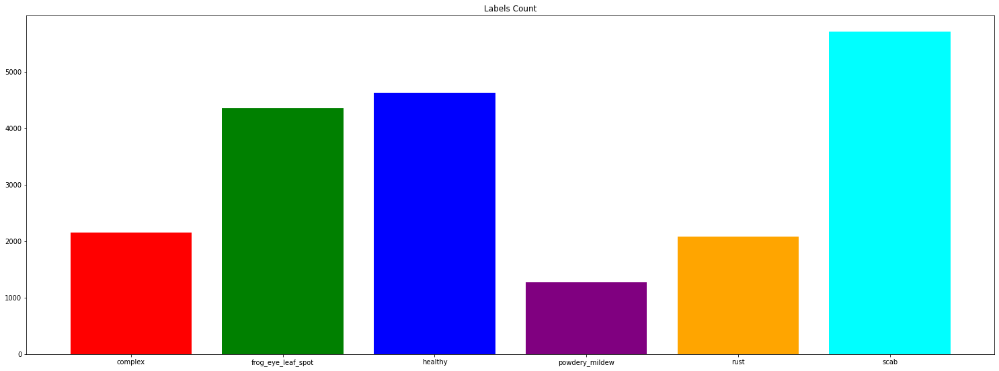

In [20]:
fig = plt.figure(figsize=(20, 7))
ax = fig.add_axes([0, 0, 1, 1])
ax.bar(data['label'], data['count'], color=['red', 'green', 'blue', 'purple', 'orange', 'cyan'])
plt.title('Labels Count')
plt.show()

## Data Samples

In [21]:
def norm(img):
    img = np.array(img)
    img = img.astype(np.float32)
    img -= img.min()
    img /= img.max()
    return img

In [22]:
def show_samples(df, class_name, path):
    plt.figure(figsize=(20, 10))

    labeled_only = df[df.labels==class_name]
    for i in range(min(len(labeled_only), 8)):
        img_name = labeled_only.iloc[i].image
        plt.subplot(3, 4, i + 1)
        plt.title(class_name)
        plt.axis('off')
        img_path = os.path.join(path, img_name)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (CFG.img_width, CFG.img_height), cv2.INTER_AREA)
        plt.imshow(norm(img))
    plt.tight_layout()
    plt.show()

### Healthy
Leaves those who do not suffer from any diseases.

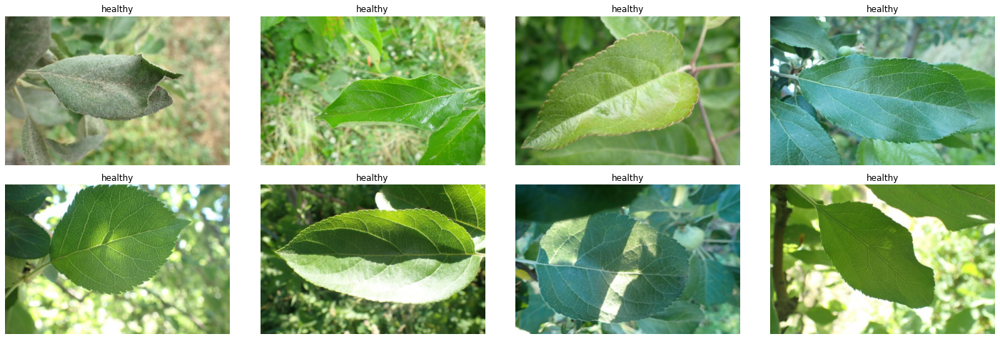

In [81]:
show_samples(df, 'healthy', images_folder)

### Scab
Scab is a bacterial or fungal plant disease characterized by crusty lesions on fruits, leaves, and stems.  
The term is also used for the symptom of the disease.

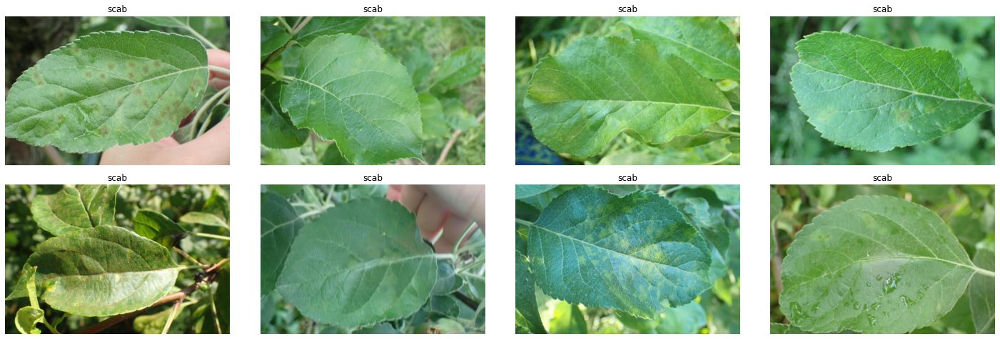

In [82]:
show_samples(df, 'scab', images_folder)

### Rust
Rust is a fungus-caused plant disease. Often appearing on leaves and fruits as yellow, orange, red, rust, brown, or black powdery pustules, rust affects many economically important plant species.

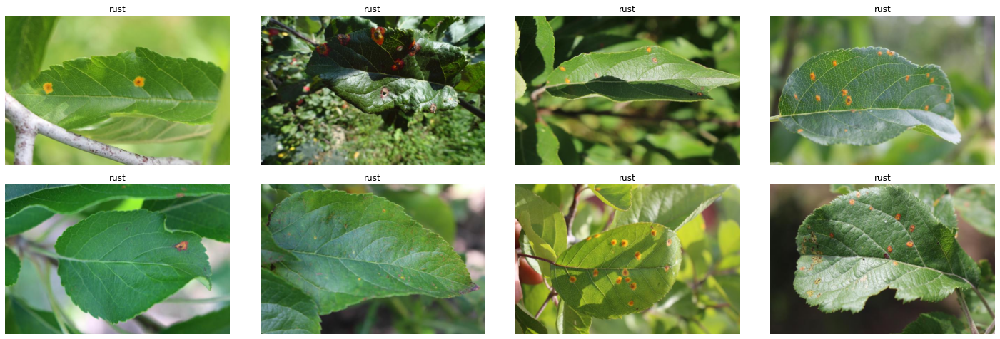

In [83]:
show_samples(df, 'rust', images_folder)

### Powdery Mildew
Many species of fungi in the order Erysiphales cause powdery mildew diseases.  
The symptoms of powdery mildew are quite distinct, making it one of the easiest diseases to identify.  
Infected plants have white powdery spots on their leaves and stems.

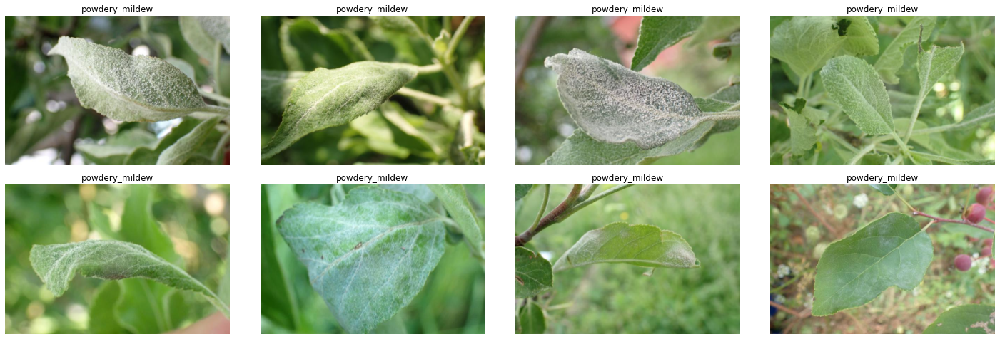

In [84]:
show_samples(df, 'powdery_mildew', images_folder)

### Frog Eye Leaf Spot
Frogeye leaf spot is caused by the fungus Cercospora sojina.  
The disease occurs across the United States and in Ontario, Canada. When widespread within a field, frogeye leaf spot can cause significant yield losses.  
Lesions on the leaves are small, irregular to circular in shape, gray with reddish brown borders.

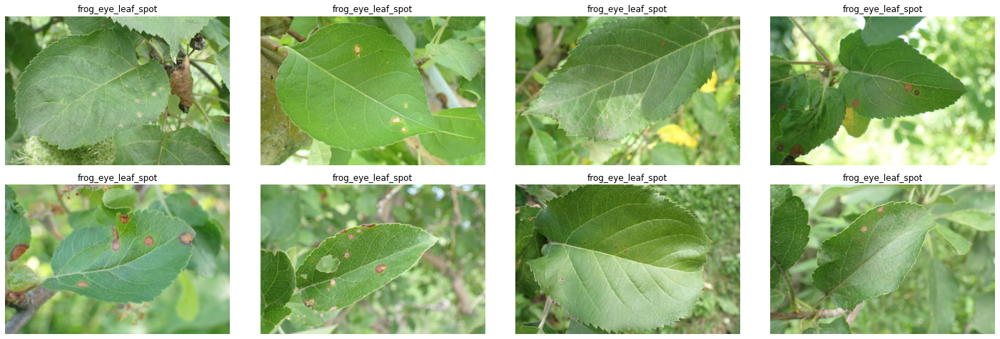

In [85]:
show_samples(df, 'frog_eye_leaf_spot', images_folder)

### Complex
As described in the competition:
> *Unhealthy leaves with too many diseases to classify visually will have the `complex` class, and may also have a subset of the diseases identified.*  


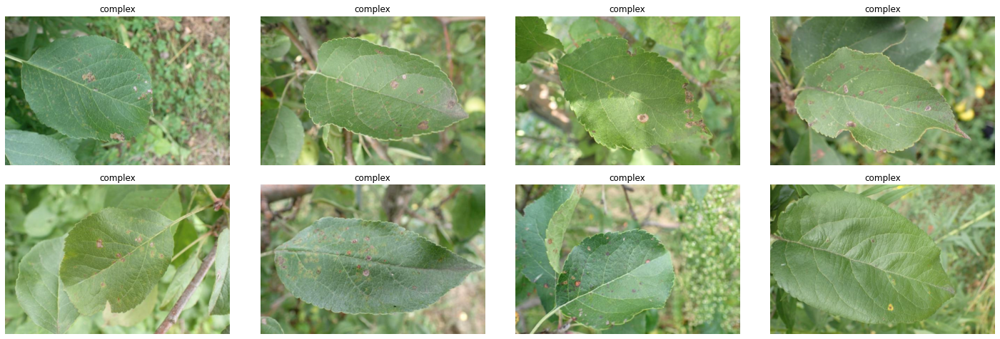

In [86]:
show_samples(df, 'complex', images_folder)

## Data Preprocessing

### Data And Dataset Classes

In [29]:
class PlantsData:
    def __init__(self, df):
        self.df = df

        self.classes = np.unique([ lbl for label in df['labels'].value_counts().keys() for lbl in label.split(' ') if lbl != 'healthy' ])
        print('Classes are: ', self.classes, 'Label not include in the training is `healthy`')

    def __len__(self):
        return len(self.df)

    def get_num_classes(self):
        return len(self.classes)

    def encode(self, labels):
        return [ 1 if self.classes[i] in labels else 0 for i in range(len(self.classes)) ]

    def decode(self, vector):
        return ''.join(filter(lambda x: x is not None, [str(self.classes[i] + ' ') if vector[i] == 1 else None for i in range(len(vector))])).rstrip() if 1 in vector else 'healthy'

    def load_data(self, train_size=.8, drop_rate=0):

        if train_size > 1 or train_size < 0:
            raise ValueError("Split sizes can not be greater than 1 or less than 0")

        images = self.df.image.to_numpy()
        labels = self.df.labels.to_numpy()
        targets = np.array([ self.encode(lbl) for lbl in labels ])

        if drop_rate > 0:
            images = images[:int(len(images) * (1 - drop_rate))]
            targets = targets[:int(len(targets) * (1 - drop_rate))]

        if train_size == 1:
            return images, targets

        test_size = 1 - train_size
        x_train, x_test, y_train, y_test = train_test_split(images, targets, test_size=test_size, random_state=CFG.seed)

        return (x_train, y_train), (x_test, y_test)

In [30]:
class PlantsDataSet(Dataset):
    def __init__(self, data, targets, path, width=CFG.img_width, height=CFG.img_height, transforms=None):
        self.x = data
        self.y = targets
        self.path = path
        self.width = width
        self.height = height
        self.transforms = transforms

    def __getitem__(self, idx, label=False):
        img_name = self.x[idx]
        y = self.y[idx]

        img_path = os.path.join(self.path, img_name)

        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        img = cv2.resize(img, (self.width, self.height), cv2.INTER_AREA)
        
        if self.transforms:
            x = self.transforms(image = img)
            x = x['image']
        else:
            x = np.transpose(x, (2, 0, 1))

        if label is True:
            return x, y, plants.decode(y)

        return x, y

    def __len__(self):
        return len(self.x)

### Augmentations
Data Augmentation reduces over-fitting. Our dataset may have images taken in a limited set of conditions but we might fall short in a variety of conditions that we don’t account for. Here the modified/augmented data helps deal with such scenarios.  

`Albumations`' image augmentation for classification provides a way to define an augmentation pipeline through which the data will pass through.  
This process is done by calling to Compose class of Albumentations, which gets all the transform functions to load into the pipeline, and returns a callable object, that by calling it, will return an augmented image. Each transform function provided to the pipeline has a probability attribute to determine if the current image should be processed by that transform or not. In that way, we can create a bunch of different augmented images and increase our dataset's size.

In [106]:
train_transformations = A.Compose([
                            A.HueSaturationValue(p=0.5),
                            A.Flip(p=0.5),
                            A.HorizontalFlip(p=0.5),
                            A.ShiftScaleRotate(p=0.5, shift_limit=(-0.1, 0.3), scale_limit=(-0.1, 0.6), rotate_limit=(-90, 90), interpolation=0, border_mode=2),
                            A.RandomBrightnessContrast(p=0.5, brightness_limit=(-0.2, 0.2), contrast_limit=(-0.2, 0.2)),
                            A.OneOf([
                                A.Blur(p=0.7),
                                A.GaussNoise(p=0.7, var_limit=(100, 400)),
                                A.MotionBlur(p=0.7),
                                A.ISONoise(p=0.7),
                            ], p=0.5),
                            A.OneOf([
                                A.GridDropout(ratio=0.3, p=0.5),
                                # A.CoarseDropout(p=0.5, max_holes=80, min_holes=50, max_height=50, max_width=50, min_height=8, min_width=8),
                                A.CoarseDropout(p=0.5, max_holes=40, max_height=20, max_width=20, min_holes=8, min_height=8, min_width=8),
                            ], p=0.5),
                            A.Normalize(
                                mean=[0.485, 0.456, 0.406],
                                std=[0.229, 0.224, 0.225],
                            ),
                            ToTensorV2(),
])

valid_transformations = A.Compose([
                            A.Normalize(
                                mean=[0.485, 0.456, 0.406],
                                std=[0.229, 0.224, 0.225],
                            ),
                            ToTensorV2(),
])

In [32]:
def show_augmentation(img_name, augmentation):
    img_path = os.path.join(images_folder, img_name)

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img = cv2.resize(img, (CFG.img_width, CFG.img_height), cv2.INTER_AREA)
    aug = A.Compose([augmentation])(image=img)['image']

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title('Original Image')

    plt.subplot(1, 2, 2)
    plt.imshow(aug)
    plt.axis('off')
    plt.title(type(augmentation).__name__)

    plt.tight_layout()
    plt.show()

In [33]:
_img_name = df.image[3500]
_img_name

'9cbe21bb0960e3e5.jpg'

#### HueSaturationValue
Randomly changes the hue saturation in the input image.

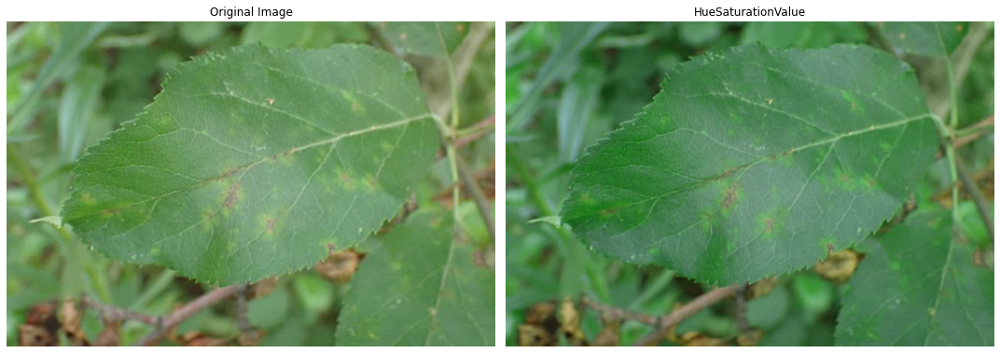

In [88]:
show_augmentation(_img_name, A.HueSaturationValue(p=1))

#### Flip
The image may be flipped horizontally, vertically, or both.

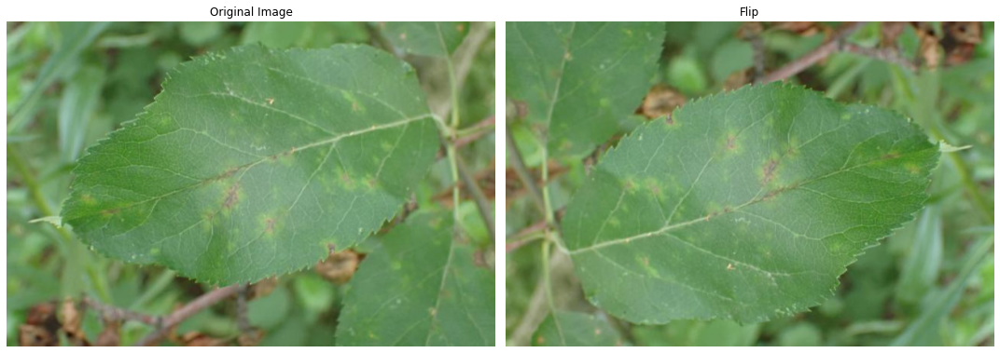

In [89]:
show_augmentation(_img_name, A.Flip(p=1))

#### HorizontalFlip
An image may only be horizontally flipped.

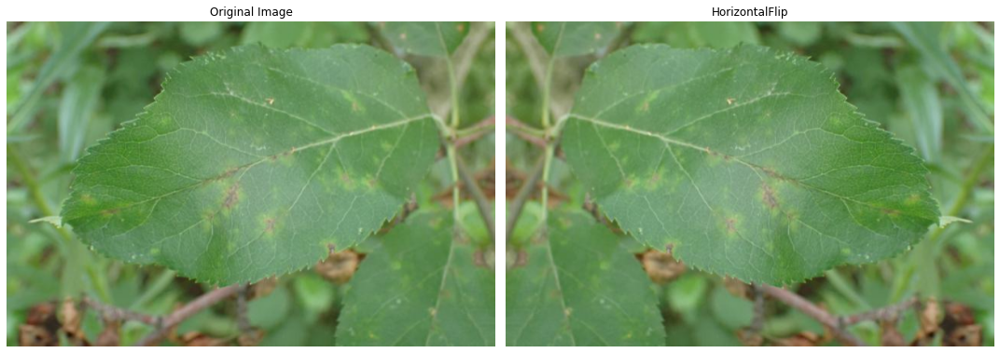

In [90]:
show_augmentation(_img_name, A.HorizontalFlip(p=1))

#### ShiftScaleRotate
The image may be rotated and its scale may be changed by shifting.  
In case the image goes beyond its own borders, some of the image will be duplicated to the black borders..

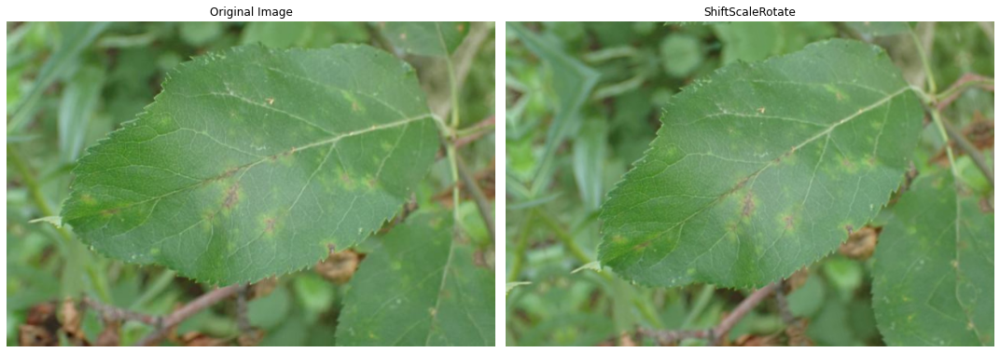

In [91]:
show_augmentation(_img_name, A.ShiftScaleRotate(p=1))

#### RandomBrightnessContrast
Change the brightness and contrast of the input image at random.

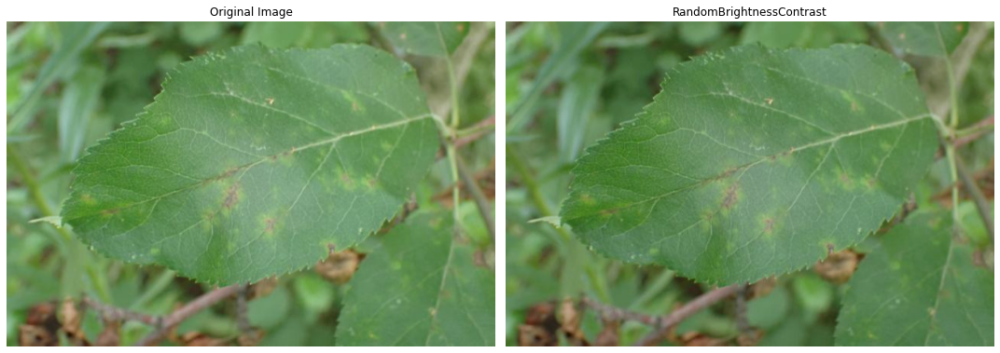

In [92]:
show_augmentation(_img_name, A.RandomBrightnessContrast(p=1, brightness_limit=(-0.2, 0.2), contrast_limit=(-0.2, 0.2)))

#### Blur
Blur the input image using a random-sized kernel.

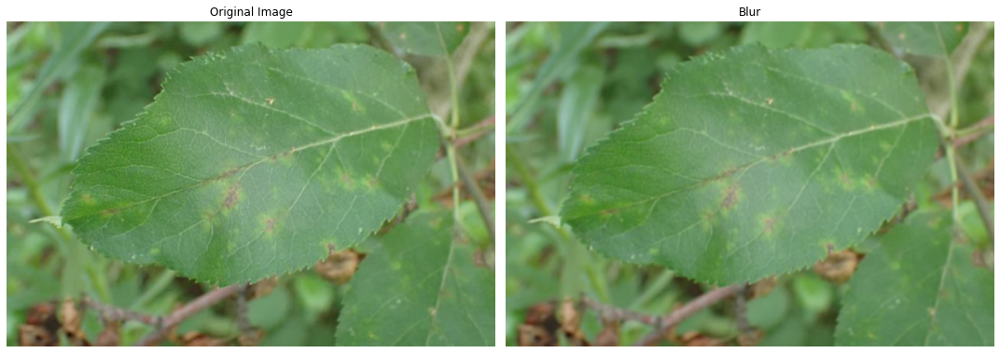

In [93]:
show_augmentation(_img_name, A.Blur(p=1))

#### GaussNoise
Apply gaussian noise to the input image.

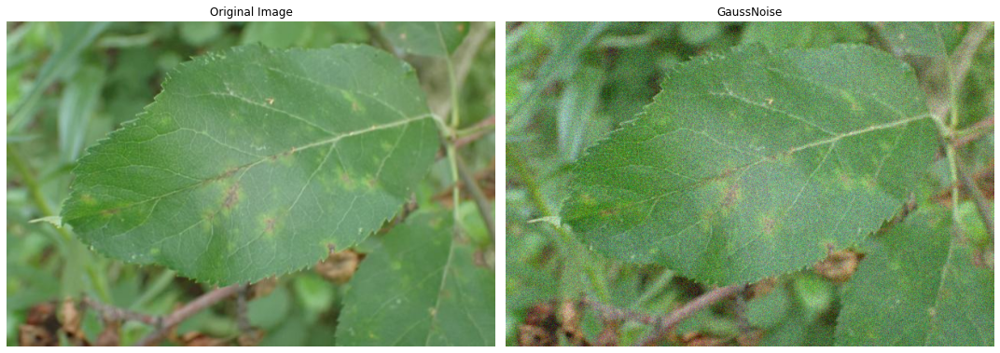

In [94]:
show_augmentation(_img_name, A.GaussNoise(p=1, var_limit=(300, 400)))

#### MotionBlur
Apply motion blur to the input image using a random-sized kernel.

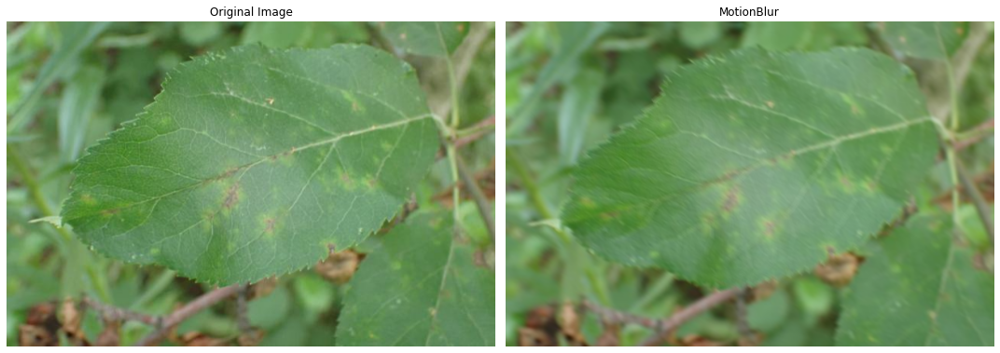

In [95]:
show_augmentation(_img_name, A.MotionBlur(p=1, blur_limit=(10, 20)))

#### ISONoise
Apply camera sensor noise to the input image.

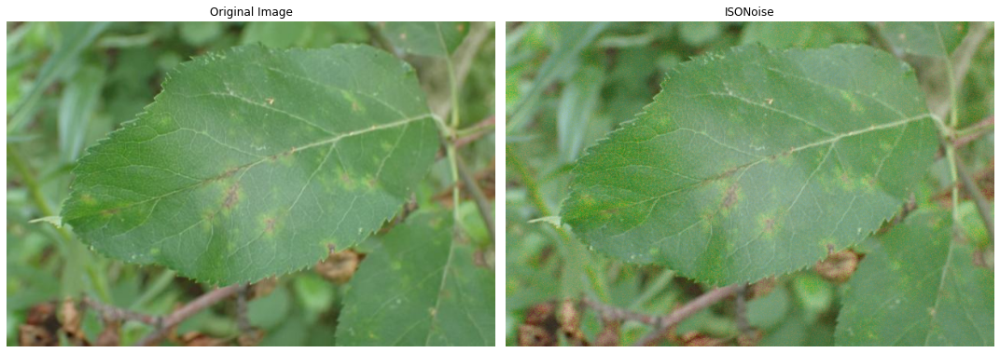

In [96]:
show_augmentation(_img_name, A.ISONoise(p=1, color_shift=(0.1, 0.5)))

#### GridDropout
Apply a grid of dropouts to the input image.

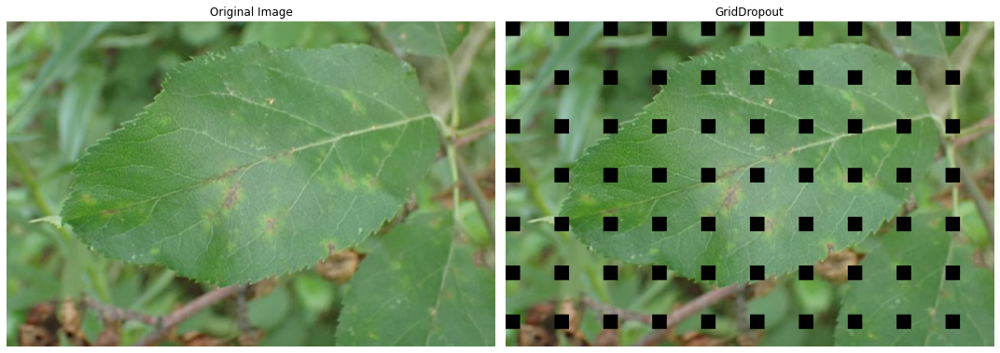

In [97]:
show_augmentation(_img_name, A.GridDropout(p=1, ratio=0.3))

#### CoarseDropout
Produces random-sized dropouts across an image.

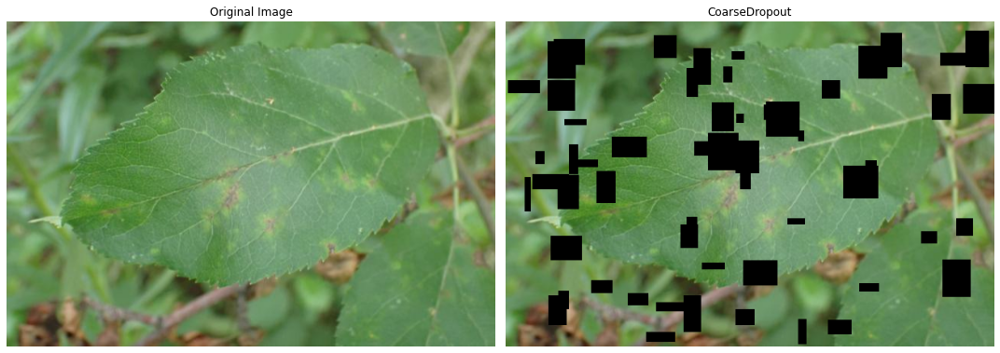

In [107]:
show_augmentation(_img_name, A.CoarseDropout(p=1, max_holes=40, max_height=20, max_width=20, min_holes=8, min_height=8, min_width=8))

#### Pre-processing Augmentations


1.   Resizing:  
As the dataset contains images of different sizes, all the images are resized to the same size before being input into the model.  

2.   Normalization:  
Data normalization is an important step that ensures that each input parameter (pixel, in this case) has a similar data distribution. This makes convergence faster while training the network.  
Data normalization is done by subtracting the mean from each pixel and then dividing the result by the standard deviation. The distribution of such data would resemble a Gaussian curve centered at zero.  

3.   ToTensor:  
Convert image to `torch.Tensor`. The NumPy HWC image is converted to PyTorch CHW tensor.


### Generate Datasets And Data-loaders


Preparing the data is a major focus in machine learning.
PyTorch provides an API to load and handle the data before using it in our algorithms.  
PyTorch's Dataset class provides a unified way to represent data. All that needs to be done is to create a class that inherits from `Dataset` and overrides the `__len__` method that returns the size of the dataset, and the `__getitem__` method that returns a specific item from the dataset by an index.  
By self-implementing `__getitem__`, we may perform some transformations on the data before returning it back. It might be useful when handling datasets with unintended size variations among images, for example.  
`Dataset` stores the samples and their corresponding labels, and `DataLoader` wraps an iterable around the Dataset to enable easy access to the samples.

In [108]:
plants = PlantsData(df)
(x_train, y_train), (x_valid, y_valid) = plants.load_data(drop_rate=0., train_size=CFG.train_size)

Classes are:  ['complex' 'frog_eye_leaf_spot' 'powdery_mildew' 'rust' 'scab'] Label not include in the training is `healthy`


In [109]:
trainset = PlantsDataSet(x_train, y_train, images_folder, transforms=train_transformations)
validset = PlantsDataSet(x_valid, y_valid, images_folder, transforms=valid_transformations)

In [110]:
print('Training set contains {} images which is {:g}% of the data'.format(len(trainset), len(trainset) * 100 / (len(trainset) + len(validset))))
print('Validation set contains {} images which is {:g}% of the data'.format(len(validset), len(validset) * 100 / (len(trainset) + len(validset))))

Training set contains 15837 images which is 84.9989% of the data
Validation set contains 2795 images which is 15.0011% of the data


In [111]:
train_loader = DataLoader(dataset=trainset, batch_size=CFG.batch_size, shuffle=True, num_workers=2)
valid_loader = DataLoader(dataset=validset, batch_size=CFG.batch_size, shuffle=False, num_workers=2)

In [112]:
dataloaders = { 'train': train_loader,
                'valid': valid_loader }

### Random Augmentations

In [121]:
def show_augmented_samples(dataset, model=None):
    plt.figure(figsize=(20, 10))
    for idx in range(12):
        img, _, lbls = dataset.__getitem__(idx + 3000, label=True)
        plt.subplot(3, 4, idx + 1)
        plt.title(lbls)
        plt.axis('off')
        img = np.transpose(img, (1, 2, 0))
        plt.imshow(norm(img))
        
    plt.tight_layout()
    plt.show()

show_augmented_samples(trainset)

Output hidden; open in https://colab.research.google.com to view.

## Loss Functions
The `Asymmetric Loss For Multi-Label Classification` function is used, which is discussed in [this](https://arxiv.org/pdf/2009.14119.pdf) article and suggested [here](https://www.kaggle.com/c/plant-pathology-2021-fgvc8/discussion/242275) (10th place).  
Compared to `Multilabel Soft Margin Loss` and `BCE with Logits Loss`, this loss function is mote effective at classifying multilabel problems.  
Mean-F1 is calculated from the F1 score. F1 scores are calculated separately for each label, and the sum is then divided by the number of labels.

### Asymetric Loss for multi-label Classification
An average picture contains few positive labels and many negative ones in a multi-label setting.  
It can lead to under-emphasizing gradients from positive labels during training, which results in poor accuracy due to the positive-negative imbalance that dominates the optimization process.  
The paper presents a novel asymmetric loss ("ASL"), which operates differently on positive and negative samples.  
The loss enables dynamically down-weights and hard-thresholds easy negative samples, while also discarding possibly mislabeled samples.

<!-- ![image](https://user-images.githubusercontent.com/52006798/126445517-8c368fa9-f040-4444-a56c-151ecf8e0d4c.png) -->
<img src="https://user-images.githubusercontent.com/52006798/126445517-8c368fa9-f040-4444-a56c-151ecf8e0d4c.png" height="300"/>  


### Focal Loss
Focal Loss (FL) is a revised version of Cross-Entropy Loss (CE) that attempts to handle the problem of class imbalance by adjusting the weights assigned to hard and easily misclassifiable examples, and to down-weight easy examples.
Focal Loss thus reduces the loss contribution from easy examples and emphasizes the importance of correcting misclassified examples.  
A focal loss function is simply an extension of the cross-entropy loss function that decreases the weight of easy examples and emphasizes training on hard negatives.


![image](https://user-images.githubusercontent.com/52006798/126446673-33d44b72-83d0-4a26-96d3-98934ba681fa.png)


The focal loss has the following properties:
1.	When an example is misclassified and pt is small, the modulating factor is near 1 and the loss is not affected.
2.	As `pt→1`, the factor is 0 and the loss for well-classified examples is downweighed.
3.	By adjusting focusing parameter `γ`, easy examples are down-weighted at a smooth rate.  
According to intuition, the modulating factor reduces the loss contribution from easy examples and extends the range in which the example receives the low loss.  
By decreasing the slope of the function, focal loss contributes to backpropagating (or weighing down) the loss.

In [51]:
class FocalLoss(nn.Module):
    def __init__(self, alpha=1, gamma=2):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.epsilon = 1e-12  # prevent training from Nan-loss error

    def forward(self, logits, target):
        """
        logits & target should be tensors with shape [batch_size, num_classes]
        """
        probs = torch.sigmoid(logits)
        one_subtract_probs = 1.0 - probs
        # add epsilon
        probs_new = probs + self.epsilon
        one_subtract_probs_new = one_subtract_probs + self.epsilon
        # calculate focal loss
        log_pt = target * torch.log(probs_new) + (1.0 - target) * torch.log(one_subtract_probs_new)
        pt = torch.exp(log_pt)
        focal_loss = -1.0 * (self.alpha * (1 - pt) ** self.gamma) * log_pt
        return torch.mean(focal_loss)

## Mean-F1
Measures of the accuracy of a model on a dataset. It is used to evaluate binary classification systems that classify examples as 'positive' or 'negative'.  
It is defined as the harmonic mean of the model's precision and recall, and it is a way to combine precision and recall.  

![image](https://user-images.githubusercontent.com/52006798/126445924-888c528b-e269-4d0a-b3c9-6a60d5b8a498.png)

## Optimizer
Optimizers are algorithms or methods used to change the attributes of your neural network such as weights and learning rate in order to reduce the losses.

### Adam
The Adam optimizer is one of the most commonly used optimizers for deep learning. When training with Adam the model usually converges a lot faster than when using regular stochastic gradient descent (SGD), and Adam often requires less tuning of the learning rate compared to SGD with momentum.  
Adam improves on SGD with momentum by (in addition to momentum) also computing adaptive learning rates for each parameter that is tuned.  
This means that when using Adam there is less need to modify the learning rate during the training than when using SGD.


### AdamW
In the common weight decay implementation in the Adam optimizer the weight decay is implicitly bound to the learning rate.  
This means that when optimizing the learning rate you will also need to find a new optimal weight decay for each learning rate you try. The AdamW optimizer decouples the weight decay from the optimization step.  
This means that the weight decay and learning rate can be optimized separately, i.e. changing the learning rate does not change the optimal weight decay.  
The result of this fix is a substantially improved generalization performance.

![image](https://user-images.githubusercontent.com/52006798/126445836-85333c93-afc8-435a-8798-071538d8660f.png)

## Learning Rate Scheduler
Learning rate scheduler provides a method to adjust the learning rate based on the number of epochs, or based on time.


## Training and Validation Functions
In the training section, we have used K-Fold Cross Validation `(k=5)`.  

### Cross-Validation
Cross-Validation is a statistical method of evaluating and comparing learning algorithms by dividing data into two segments: one used to learn or train a model and the other used to validate the model.  
In typical cross-validation, the training and validation sets must cross-over in successive rounds such that each data point has a chance of being validated against.  
In `k-fold` cross-validation, the data is first partitioned into `k` equally (or nearly equally) sized segments or folds.  
Subsequently `k` iterations of training and validation are performed such that within each iteration a different fold of the data is held-out for validation while the remaining `k − 1` folds are used for learning.  
<img src="http://ethen8181.github.io/machine-learning/model_selection/img/kfolds.png" height="300"/>



In [52]:
def train(model, loaders, optimizer, criterion, scheduler, metrics_m, epochs, writers, path):
    print('This running path is: `{}`\n'.format(path))
    time.sleep(1)
    device = CFG.device

    model = model.to(device)
    criterion = criterion.to(device)
    for met in metrics_m:
        metrics_m[met] = metrics_m[met].to(device)
    
    statistics = pd.DataFrame(columns=['phase', 'epoch', 'loss', 'accuracy', 'f1'])

    best_f1 = 0     #   the model will be saved based on the f1 score of each iteration

    for epch in range(1, epochs + 1):              #   iterate epoch
        print('Epoch {:3d}:'.format(epch), flush=True)
        epoch_print = '\n'
        for phase in ['train', 'valid']:    #   iterate phases
            if phase == 'train':
                model.train()
            else:
                model.eval()
            torch.autograd.set_grad_enabled(phase == 'train')

            with tqdm(total=len(loaders[phase]), desc=phase) as progress_bar:               #   define progress bas
                running_loss, running_accuracy, running_f1, samples = 0.0, 0.0, 0.0, 0      #   reset epoch-phase metrics
                for x_batch, y_batch in loaders[phase]:                                     #   iterate batches
                    x_batch, y_batch  = x_batch.float().to(device), y_batch.to(device)
                    samples += y_batch.size(0)              #   count samples to average the epoch loss
                    optimizer.zero_grad()

                    output = model(x_batch)
                    loss = criterion(output, y_batch.float())
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                    #   aggregate the loss, accuracy, and f1 across all batches
                    running_loss      += loss.item()
                    running_accuracy  += metrics_m['accuracy'](torch.sigmoid(output), y_batch)
                    running_f1        += metrics_m['f1'](torch.sigmoid(output), y_batch)

                    del x_batch
                    del y_batch
                    del output
                    del loss
                    torch.cuda.empty_cache()
                    progress_bar.update(1)
                
                if phase == 'train' and scheduler is not None:
                    writers['train'].add_scalar('lr epoch', scheduler.get_last_lr()[0], epch)
                    scheduler.step()

            #   calculate loss, accuracy, and f1 of the whole epoch
            epch_loss   = running_loss / samples
            epch_acc    = running_accuracy / len(loaders[phase])
            epch_f1     = running_f1 / len(loaders[phase])

            writers[phase].add_scalar('loss epoch', epch_loss, epch)
            writers[phase].add_scalar('accuracy epoch', epch_acc.cpu().numpy(), epch)
            writers[phase].add_scalar('f1 epoch', epch_f1.cpu().numpy(), epch)

            statistics = statistics.append({    'phase' : phase,
                                                'epoch' : epch,
                                                'loss'  : epch_loss,
                                                'accuracy'  :   epch_acc.cpu().numpy(),
                                                'f1'    :   epch_f1.cpu().numpy()
                                            }, ignore_index=True)

            #   print epoch's results
            epoch_print += '{0} loss: {1:.6f}\t{0} accuracy: {2:.6f}\t{0} f1: {3:.6f}\n'.format(
                            phase,
                            epch_loss,
                            epch_acc,
                            epch_f1,
                        )
        
        print(epoch_print, flush=True)
        
        #   if the model perform better in this epoch, save it's parameters
        if epch_f1 > best_f1:
            best_f1 = epch_f1
            torch.save(model.state_dict(), path)
    
    return statistics

In [53]:
def train_cv(model, folds=5, epochs=10):

    fold = 0

    criterion = AsymmetricLossOptimized()
    optimizer = optim.AdamW(model.parameters())
    # scheduler = optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.01, epochs=epochs * folds, steps_per_epoch=446)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, epochs * folds)
    metrics_m = { 'f1' :      F1(num_classes=plants.get_num_classes(), average='macro'),
                  'accuracy' :  Accuracy(num_classes=plants.get_num_classes()), }

    running_name = '{} {}'.format(CFG.model_name, datetime.today().strftime("%d-%m-%y %H:%M"))
    running_folder = os.path.join(GOOGLE_DRIVE_PATH, 'models', running_name)
    if not os.path.exists(running_folder):
        os.mkdir(running_folder)

    x, y = plants.load_data(train_size=1, drop_rate=0.)
    kf = KFold(n_splits=folds, shuffle=True)
    for train_index, valid_index in kf.split(x, y):         #   iterate over the different splits
        fold += 1
        print('Fold {} of {}'.format(fold, folds))

        #   get split's train and validation sets
        x_train_fold = x[train_index] 
        y_train_fold = y[train_index] 
        x_valid_fold = x[valid_index] 
        y_valid_fold = y[valid_index]

        trainset = PlantsDataSet(x_train_fold, y_train_fold, images_folder, transforms=train_transformations)
        validset = PlantsDataSet(x_valid_fold, y_valid_fold, images_folder, transforms=valid_transformations)

        train_loader = DataLoader(dataset=trainset, batch_size=CFG.batch_size, shuffle=True, num_workers=2)
        valid_loader = DataLoader(dataset=validset, batch_size=CFG.batch_size, shuffle=False, num_workers=2)

        loaders = { 'train': train_loader,
                    'valid': valid_loader }

        model_path = os.path.join(running_folder, '{}_{}kfold.pth'.format(CFG.model_name, fold))

        writer_train_epoch = SummaryWriter('{}/{}_train_{}'.format(logs_folder, CFG.model_name, fold))
        writer_valid_epoch = SummaryWriter('{}/{}_valid_{}'.format(logs_folder, CFG.model_name, fold))

        epoch_writers = { 'train': writer_train_epoch,
                          'valid': writer_valid_epoch }
        
        #   train model with this fold for several epochs
        stats = train(model, loaders, optimizer, criterion, scheduler, metrics_m, epochs, epoch_writers, model_path)
        cvs_name = './{}_fold.csv'.format(fold)
        csv_path = os.path.join(running_folder, cvs_name)
        stats.to_csv(csv_path, index=False)
        print()
            
        # save logs to the running folder
        zipFilesInDir(logs_folder, '{}/graphs.zip'.format(running_folder), None)

In [54]:
%tensorboard --logdir=logs

Output hidden; open in https://colab.research.google.com to view.

In [55]:
def zipFilesInDir(dirName, zipFileName, filter):
   with ZipFile(zipFileName, 'w') as zipObj:
       for folderName, subfolders, filenames in os.walk(dirName):
           for filename in filenames:
            #    if filter(filename):
                filePath = os.path.join(folderName, filename)
                zipObj.write(filePath, os.path.basename(filePath))

## Models
As a first step, we'll train some pre-trained CNN's that others extensively used in the competition.  
The networks are:
*   EfficientNet-B4
*   ResNext50
*   SEResNeXt50



### Transfer Learning
<!-- ![](https://pennylane.ai/qml/_images/transfer_learning_general.png) -->
<img src="https://pennylane.ai/qml/_images/transfer_learning_general.png" width="500"/>  

In machine learning, transfer learning refers to storing knowledge gained while solving one problem and applying it to another, related problem.  
The pre-trained model is trained on a different task than the one at hand, but provides a very useful starting point since the features learned while training on the old task are useful when training for the new one.


<img src="https://research.aimultiple.com/wp-content/uploads/2020/07/Transfer_Learning_vs_Traditional_Learning.png" width="500"/>


* **Better initial model**: Transfer learning is a better starting point for building a model without any knowledge, and can perform tasks at a certain level even without training.
* **Higher accuracy after training**: Transfer learning allows a machine learning model to converge at a higher performance level, resulting in more accurate output.
* **Faster training**: By using a pre-trained model, the training can achieve the desired performance faster than traditional methods.
* **Fighting Overfitting**: Transfer learning's main advantage is that it mitigates the problems associated with insufficient training data. This is one of the causes of overfitting.


### Freezeing Layers
Freezing a layer in the context of neural networks is about controlling the way the weights are updated. Layers that are frozen cannot be modified further.  
The idea with this technique, as obvious as it may sound, is to shorten the training time while maintaining accuracy.  
By gradually freezing hidden layers, you can accelerate the training process of neural networks.  
In our models, we used batch-noramalization freeze:  
On a standard GPU, the batch size is typically quite small due to the memory requirements. Batch normalization will be difficult (as it requires a large batch size).  
A freeze of the weights is a good solution since the network is pre-trained based on ImageNet. (This approach is taken in faster-CNN and similar projects).

### Model Loader

In [56]:
def model_loader(name):

    if any(_name in name for _name in ['efficientnet', 'seresnext', 'resnext']):
        model = timm.create_model(name, pretrained=CFG.pretrained, drop_rate=CFG.drop_rate, num_classes=plants.get_num_classes())

        for name, child in model.named_children():
            if name.find('bn') != -1:               #   freeze batch-normalized layers
                for param in child.parameters():
                    param.requires_grad = False

            
    return model

### Training

In [ ]:
t = 

In [67]:
model = model_loader(CFG.model_name)
model.load_state_dict(torch.load('./efficientnet_b4_4fold bigger v2.pth'))

Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/efficientnet_b4_ra2_320-7eb33cd5.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b4_ra2_320-7eb33cd5.pth


<All keys matched successfully>

In [68]:
train_cv(model, folds=CFG.n_folds, epochs=CFG.n_epochs)

Fold 1 of 5
This running path is: `drive/My Drive/Colab Notebooks/Computer Vision/Final Assignment/models/efficientnet_b4 24-07-21 11:18/efficientnet_b4_1kfold.pth`

Epoch   1:


valid: 100%|██████████| 117/117 [00:30<00:00,  3.86it/s]



train loss: 0.061967	train accuracy: 0.963716	train f1: 0.865167
valid loss: 0.023500	valid accuracy: 0.985303	valid f1: 0.913560

Epoch   2:


valid: 100%|██████████| 117/117 [00:30<00:00,  3.87it/s]


train loss: 0.056407	train accuracy: 0.966476	train f1: 0.873489
valid loss: 0.032076	valid accuracy: 0.983106	valid f1: 0.907314

Epoch   3:



valid: 100%|██████████| 117/117 [00:30<00:00,  3.87it/s]


train loss: 0.058895	train accuracy: 0.965689	train f1: 0.872497
valid loss: 0.039120	valid accuracy: 0.977443	valid f1: 0.895985

Epoch   4:



valid: 100%|██████████| 117/117 [00:30<00:00,  3.87it/s]


train loss: 0.053252	train accuracy: 0.968158	train f1: 0.879021
valid loss: 0.040885	valid accuracy: 0.984929	valid f1: 0.910278

Epoch   5:



valid: 100%|██████████| 117/117 [00:30<00:00,  3.89it/s]


train loss: 0.053612	train accuracy: 0.969020	train f1: 0.882872
valid loss: 0.046363	valid accuracy: 0.976033	valid f1: 0.893861

Epoch   6:



valid: 100%|██████████| 117/117 [00:30<00:00,  3.90it/s]


train loss: 0.051505	train accuracy: 0.969133	train f1: 0.884350
valid loss: 0.047163	valid accuracy: 0.979580	valid f1: 0.891807



Epoch   7:


valid: 100%|██████████| 117/117 [00:30<00:00,  3.88it/s]


train loss: 0.049465	train accuracy: 0.970344	train f1: 0.882810
valid loss: 0.048639	valid accuracy: 0.974758	valid f1: 0.884553

Epoch   8:



valid: 100%|██████████| 117/117 [00:30<00:00,  3.88it/s]


train loss: 0.050965	train accuracy: 0.969111	train f1: 0.882738
valid loss: 0.048853	valid accuracy: 0.979006	valid f1: 0.894323

Epoch   9:



valid: 100%|██████████| 117/117 [00:30<00:00,  3.87it/s]



train loss: 0.048620	train accuracy: 0.972199	train f1: 0.886350
valid loss: 0.054831	valid accuracy: 0.974498	valid f1: 0.886659

Epoch  10:


valid: 100%|██████████| 117/117 [00:30<00:00,  3.86it/s]


train loss: 0.045387	train accuracy: 0.974010	train f1: 0.894559
valid loss: 0.056839	valid accuracy: 0.974865	valid f1: 0.885647



## Ensemble Voting Classifier
<!-- ![Ensemble](https://user-images.githubusercontent.com/52006798/126038996-98073007-4903-4c64-9b13-afd89f6d034e.png) -->


<img src="https://user-images.githubusercontent.com/52006798/126038996-98073007-4903-4c64-9b13-afd89f6d034e.png" width="800"/>

When performing cross validation, in the process, we generate `K` similar models, which each one is trained over a bit different data. Therefore, in each of these folds, we generate a bit different models.  
We can use each of these models and generate an ensemble classifier, which as explained above, is better than using a single model.


## EfficientNet
EfficientNet is a convolutional neural network architecture and scaling method that uniformly scales all dimensions of depth/width/resolution using a compound coefficient.  
Unlike conventional practice that arbitrary scales these factors, the EfficientNet scaling method uniformly scales network width, depth, and resolution with a set of fixed scaling coefficients.  
The compound scaling method is justified by the intuition that if the input image is bigger, then the network needs more layers to increase the receptive field and more channels to capture more fine-grained patterns on the bigger image.  
Compound Model Scaling: A Better Way to Scale Up CNNs
In order to understand the effect of scaling the network, we systematically studied the impact of scaling different dimensions of the model.  
While scaling individual dimensions improves model performance, we observed that balancing all dimensions of the network—width, depth, and image resolution—against the available resources would best improve overall performance.  
(B – number of iterations)

<!-- ![image](https://user-images.githubusercontent.com/52006798/126446173-b3f5ae69-883c-415c-9529-bc448356c6b0.png) -->
<img src="https://user-images.githubusercontent.com/52006798/126446173-b3f5ae69-883c-415c-9529-bc448356c6b0.png" width="600"/>


## ResNeXt
ResNeXt is based on ResNet architecture, but with another dimentional called `cardinality`.  
It aggregates a set of transformations to the image.  
Instead of using linear function in a simple neuron that `wi` times `xi` in each path, a nonlinear function is performed for each path.  
<!-- ![](https://miro.medium.com/max/875/1*r_63luxLeVstJMzd0o-8Iw.png) -->

<img src="https://miro.medium.com/max/875/1*r_63luxLeVstJMzd0o-8Iw.png" width="600"/>


## SEResNext
SEResNext is ResNext-50 with Squeeze-and-Excitation blocks.  
Squeeze-and-Excitation Networks (SENets) introduce a building block for CNNs that improves channel interdependencies at almost no computational cost.  
Besides this huge performance boost, they can be easily added to existing architectures.  
<!-- ![](https://miro.medium.com/max/748/1*WNk-atKDUsZPvMddvYL01g.png) -->
<img src="https://miro.medium.com/max/748/1*WNk-atKDUsZPvMddvYL01g.png" width="500"/>



## Results Examples

In [ ]:
t = 

In [69]:
model = model_loader(CFG.model_name)
model = model.to(CFG.device)
model.load_state_dict(torch.load('./efficientnet_b4_5fold bigger v2.pth'))
model = model.eval()

In [70]:
def get_t_f(model, dataset):

    t = []
    f = []
    idx = 0
    while len(t) < 12 or len(f) < 12:

        img, t_pred, lbls = dataset.__getitem__(idx, label=True)
        img = img.to(CFG.device)

        pred = model(img[np.newaxis, :, :, :])
        pred[pred < 0.5] = 0
        pred[pred >= 0.5] = 1
        pred = pred.cpu().detach().numpy()[0]

        if (pred == t_pred).all() and len(t) < 12:
            t.append(idx)
        elif len(f) < 12 and not (pred == t_pred).all():
            f.append(idx)

        idx += 1

        del img
        del pred
    
    return t, f

In [71]:
t_list, f_list = get_t_f(model, validset)

In [72]:
def show_results(model, dataset, idx_list, title=None):
    plt.figure(figsize=(30, 30), tight_layout=True)
    plt.suptitle(title, y=1, fontsize=25)

    plt_idx = 1
    for idx in idx_list:
        img, t_pred, lbls = dataset.__getitem__(idx, label=True)
        img = img.to(CFG.device)
        plt.subplot(4, 3, plt_idx)
        plt_idx += 1

        pred = model(img[np.newaxis, :, :, :])
        pred[pred < 0.5] = 0
        pred[pred >= 0.5] = 1
        pred = pred.cpu().detach().numpy()[0]

        pred = plants.decode(pred)
        plt.title('Real: {}\nPrediction: {}'.format(lbls, pred), fontsize=20)
        plt.axis('off')
        img = img.cpu()
        img = np.transpose(img, (1, 2, 0))
        plt.imshow(norm(img))
        del img
        del pred
        
    plt.subplots_adjust(top=1.1)
    plt.show()

In [73]:
show_results(model, validset, t_list, 'Correct Predictions')

Output hidden; open in https://colab.research.google.com to view.

In [74]:
show_results(model, validset, f_list, 'Incorrect Predictions')

Output hidden; open in https://colab.research.google.com to view.

In [75]:
folds = [pd.read_csv('./{}_fold.csv'.format(i)) for i in range(1, 6, 1)]

In [76]:
def print_graphs(data, fold):
    plt.figure(figsize=(25, 5))
    plt.suptitle('Fold {}'.format(fold), fontsize=20, y=1)

    for i, stat in enumerate(['loss', 'accuracy', 'f1']):
        plt.subplot(1, 3, i + 1)
        plt.plot(range(1, 11, 1), data[data['phase']=='train'][stat].tolist())
        plt.plot(range(1, 11, 1), data[data['phase']=='valid'][stat].tolist())
        plt.title(stat)
        plt.legend(['Train','Validation'])
    
    plt.show()

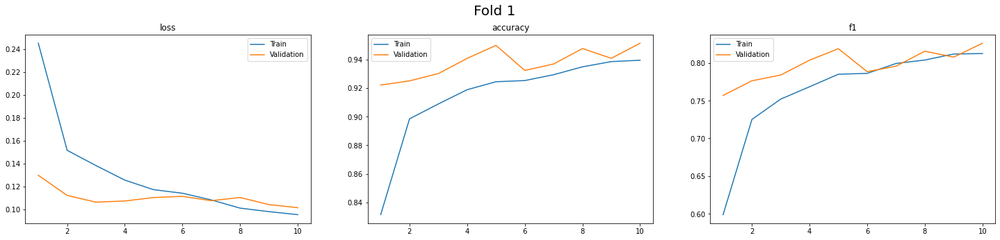

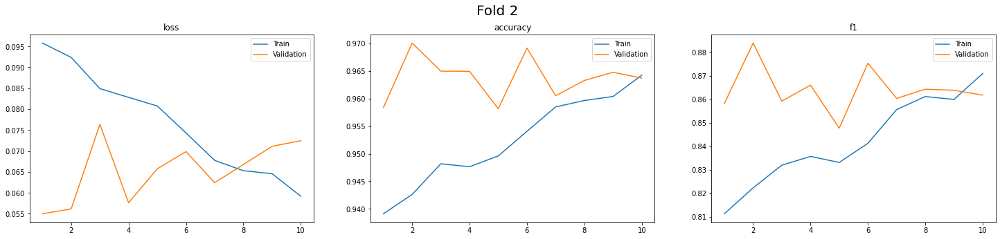

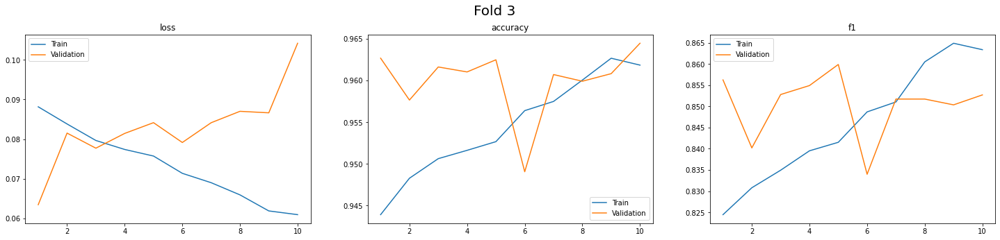

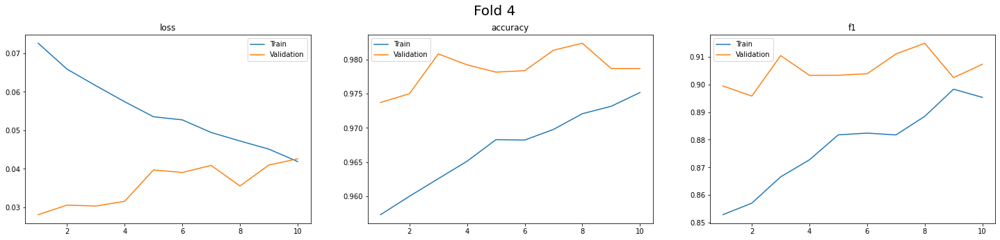

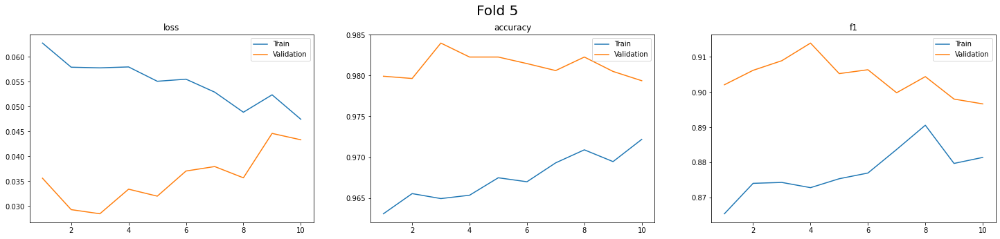

In [77]:
for i, fold in enumerate(folds):
    print_graphs(fold, i + 1)

## Summary
In our final project, we participated in Kaggle's competition of classifying images of apple leaves disease.
We had to implement the knowledge gained during the `Computer Vision` course:

* Dataset and Dataloader.
* Image Augmentations.
* Training CNN models.
* Optimizers, Loss functions, and Learning Rate Schedulers.
* Cross-Validation.
* Transfer Learning.
* Ensemble.  

Moreover, we had to acquire knowledge from other sources in order to achieve better results:
* Layer Freeze.
* Batch-Normalization.
* Multi-Label Classification.
* Voting Classifier.
* Synchronize Colab's notebooks with Kaggle's.  

Combining all of these methods, we were able to achieve an F1 score of **0.8353** in the Private Score and **0.8241** in the Public Score.


## Best Submission

![image](https://user-images.githubusercontent.com/52006798/126469083-d46ac178-9fe8-4c76-963f-7046737bf341.png)


## Last Submission
![image](https://user-images.githubusercontent.com/52006798/126469272-78fb98c9-6443-4adc-b0bb-c3d58c15cf6f.png)

## References


*   https://github.com/clcarwin/focal_loss_pytorch/blob/master/focalloss.py
*   https://www.kaggle.com/buinyi/understanding-the-evaluation-metric-cv?scriptVersionId=57391136
*   https://www.kaggle.com/c/plant-pathology-2021-fgvc8/discussion/243042
*   https://www.kaggle.com/c/plant-pathology-2021-fgvc8/discussion/242843
*   https://www.kaggle.com/c/plant-pathology-2021-fgvc8/discussion/242454
*   https://www.kaggle.com/c/plant-pathology-2021-fgvc8/discussion/242275
*   https://www.kaggle.com/c/plant-pathology-2021-fgvc8/discussion/227032
*   https://github.com/facebookresearch/ResNeXt

